# How to Train Detectron2 on Custom Objects

This tutorial implements the new [Detectron2 Library](https://ai.facebook.com/blog/-detectron2-a-pytorch-based-modular-object-detection-library-/) by facebook. This notebook shows training on **your own custom objects** for object detection.

It is worth noting that the Detectron2 library goes far beyond object detection, supporting semantic segmentation, keypoint detection, mask, and densepose.


### Steps Covered in This Tutorial

In this tutorial, we will walk through the steps required to train Detectron2 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install Detectron2 dependencies
* Download custom Detectron2 object detection data
* Visualize Detectron2 training data
* Write our Detectron2 training configuration
* Run Detectron2 training
* Evaluate Detectron2 performance
* Run Detectron2 inference on test images

# Install Detectron2 Dependencies

In [ ]:
# # install dependencies
# !pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
# !pip install cython pyyaml==5.1
# !pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
# import torch, torchvision
# print(torch.__version__, torch.cuda.is_available())
# !gcc --version
# !apt-get update
# !apt-get install ffmpeg libsm6 libxext6  -y
# # opencv is pre-installed on Gradient

In [ ]:
# # install detectron2:
# !pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



# Import and Register Custom Detectron2 Data

We're grabbing our dataset from [Roboflow](https://roboflow.ai), where it's already labeled for us. Roboflow enables teams to deploy custom computer vision models quickly and accurately. Convert data from and to annotation format, assess dataset health, preprocess, augment, and more.

In [ ]:
# !curl -L "YOUR DATASET LINK HERE" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "./train/_annotations.coco.json", "./train")
register_coco_instances("my_dataset_val", {}, "./valid/_annotations.coco.json", "./valid")
register_coco_instances("my_dataset_test", {}, "./test/_annotations.coco.json", "./test")

WARNING [03/24 10:29:14 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



[03/24 10:29:14 d2.data.datasets.coco]: Loaded 255 images in COCO format from ./train/_annotations.coco.json


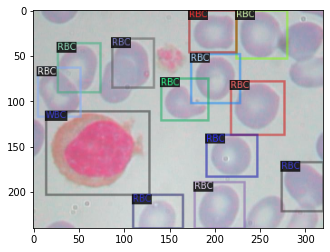

In [ ]:
# visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [ ]:
# We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
# from .detectron2.tools.train_net import Trainer
# from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500  # adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05


cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4 # your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[03/18 09:11:19 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.


[03/18 09:11:20 d2.engine.train_loop]: Starting training from iteration 0
[03/18 09:11:47 d2.utils.events]:  eta: 0:33:07  iter: 19  total_loss: 3.031  loss_cls: 1.608  loss_box_reg: 0.840  loss_rpn_cls: 0.528  loss_rpn_loc: 0.092  time: 1.3534  data_time: 0.0187  lr: 0.000020  max_mem: 5290M
[03/18 09:12:13 d2.utils.events]:  eta: 0:32:46  iter: 39  total_loss: 2.330  loss_cls: 1.293  loss_box_reg: 0.880  loss_rpn_cls: 0.093  loss_rpn_loc: 0.073  time: 1.3392  data_time: 0.0049  lr: 0.000040  max_mem: 5290M
[03/18 09:12:40 d2.utils.events]:  eta: 0:32:00  iter: 59  total_loss: 1.822  loss_cls: 0.865  loss_box_reg: 0.840  loss_rpn_cls: 0.037  loss_rpn_loc: 0.062  time: 1.3310  data_time: 0.0050  lr: 0.000060  max_mem: 5290M
[03/18 09:13:07 d2.utils.events]:  eta: 0:31:42  iter: 79  total_loss: 1.610  loss_cls: 0.676  loss_box_reg: 0.838  loss_rpn_cls: 0.049  loss_rpn_loc: 0.058  time: 1.3370  data_time: 0.0050  lr: 0.000080  max_mem: 5290M
[03/18 09:13:34 d2.utils.events]:  eta: 0:31:1

In [ ]:
# import torch
# import gc
# gc.collect()
# torch.cuda.empty_cache()

In [ ]:
# # Look at training curves in tensorboard:
# %load_ext tensorboard
# %tensorboard --logdir output

In [ ]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [03/18 09:47:54 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/18 09:47:54 d2.data.datasets.coco]: Loaded 36 images in COCO format from ./test/_annotations.coco.json
[03/18 09:47:54 d2.data.build]: Distribution of instances among all 4 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|   cells    | 0            | Platelets  | 36           |    RBC     | 398          |
|    WBC     | 37           |            |              |            |              |
|   total    | 471          |            |              |            |              |
[03/18 09:47:54 d2.data.common]: Serializing 36 elements to byte tensors and concatenating them all ...
[03/18 09:47:54 d2.data.common]: Serialized dataset takes 0.02 MiB
[03/18 09:47:54 d2.evaluation.evaluator]: Start inference on 36 images
[

OrderedDict([('bbox',
              {'AP': 58.582221871954246,
               'AP50': 86.32230458346731,
               'AP75': 67.37805415225844,
               'APs': 18.617369429250616,
               'APm': 47.101073234295185,
               'APl': 47.67492619836467,
               'AP-cells': nan,
               'AP-Platelets': 38.81576702291712,
               'AP-RBC': 60.45183613368514,
               'AP-WBC': 76.47906245926049})])

# Inference With Detectron2 Saved Weights



In [ ]:
%ls ./output/

coco_instances_results.json
events.out.tfevents.1615983309.npiqtzjf.2896.0
events.out.tfevents.1615983929.npiqtzjf.2896.1
events.out.tfevents.1615983962.npiqtzjf.2967.0
events.out.tfevents.1615984031.npiqtzjf.3046.0
events.out.tfevents.1615984133.npiqtzjf.3097.0
events.out.tfevents.1615984194.npiqtzjf.3150.0
events.out.tfevents.1615984280.npiqtzjf.3203.0
events.out.tfevents.1615994342.npiqtzjf.3203.1
events.out.tfevents.1616073080.ny17nsds.349.0
instances_predictions.pth
last_checkpoint
metrics.json
model_final.pth


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

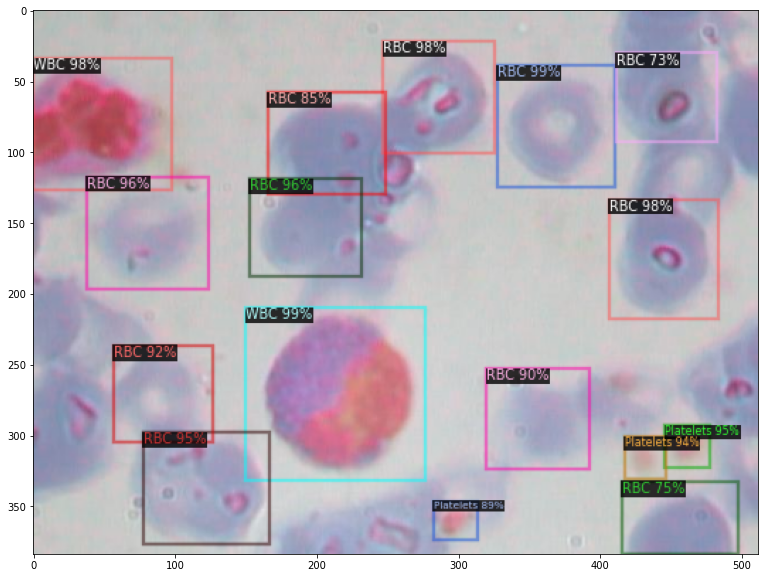

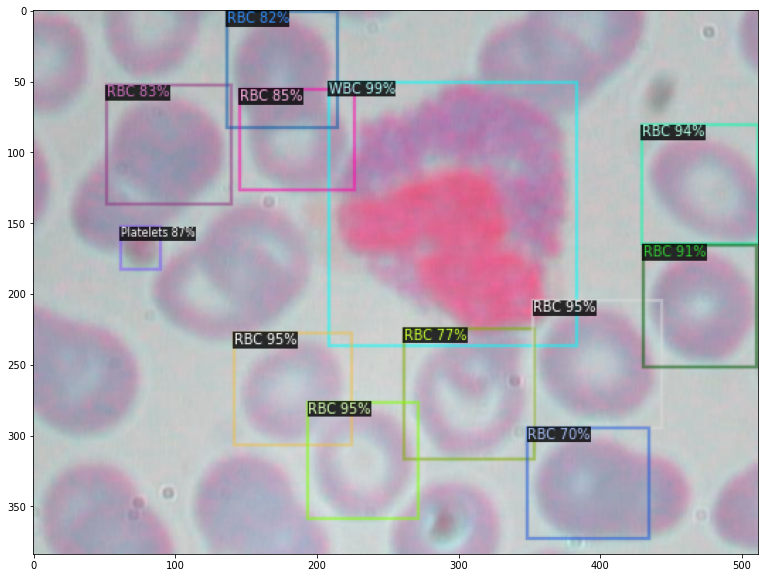

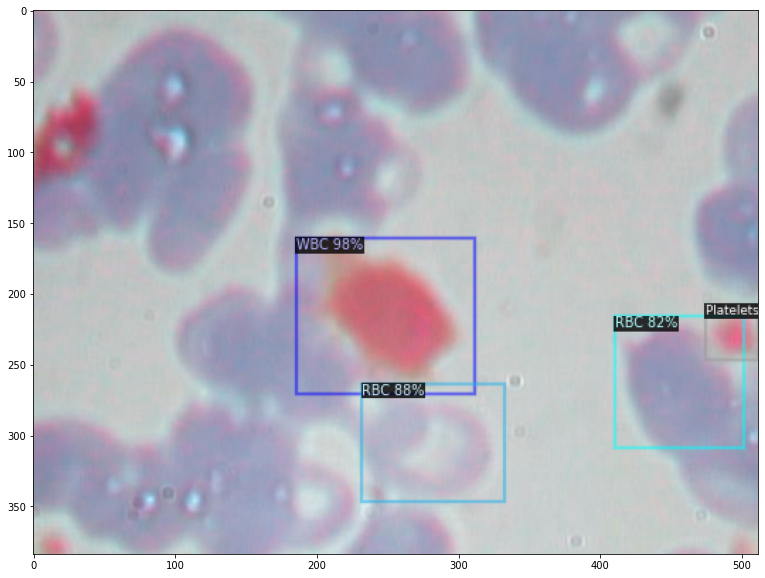

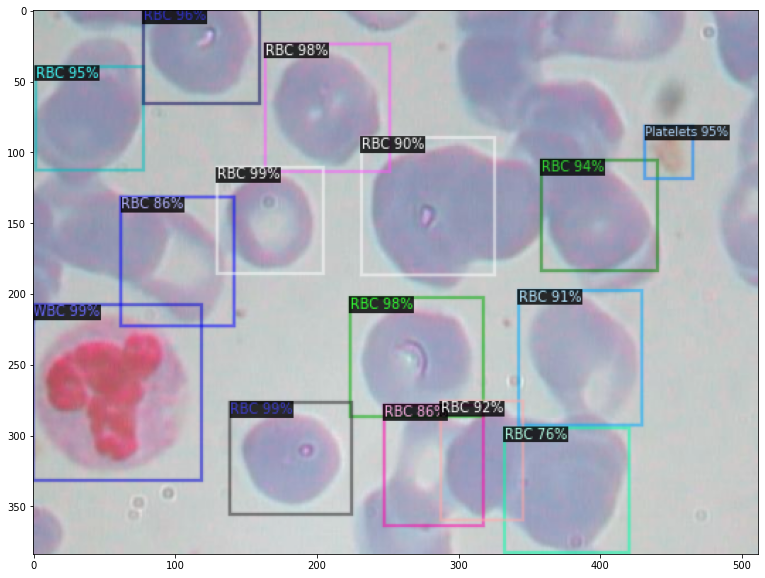

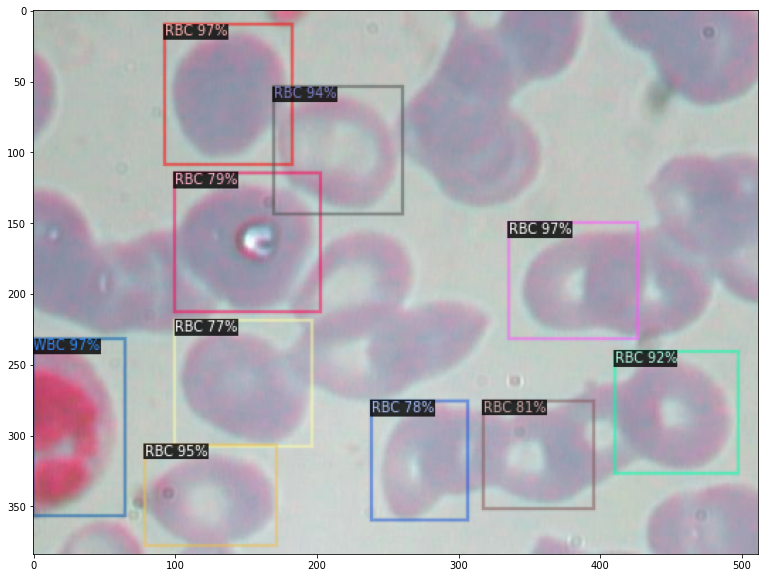

...

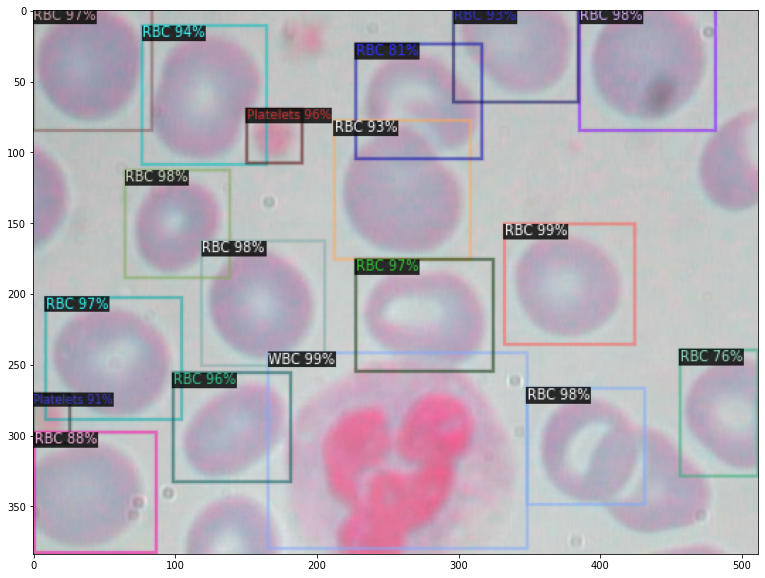

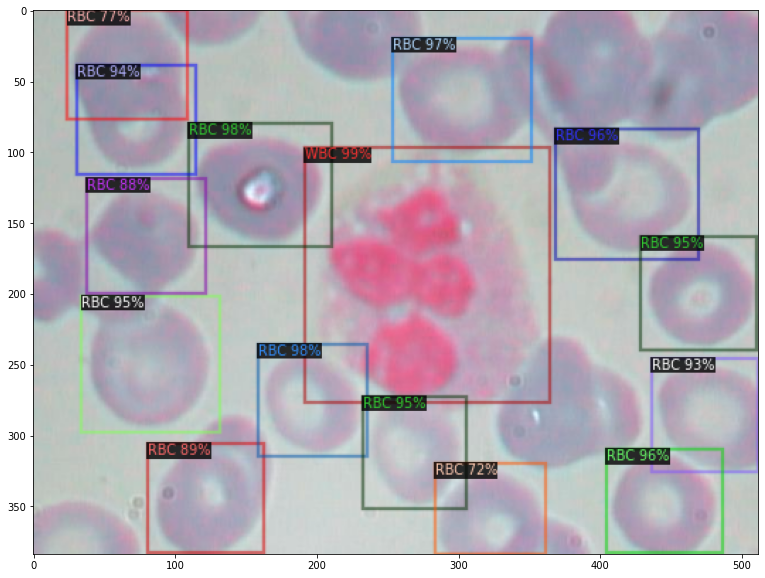

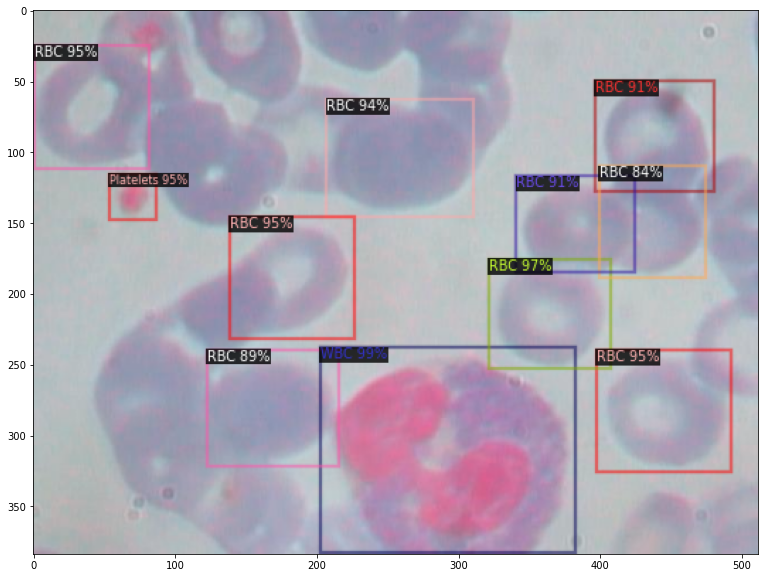

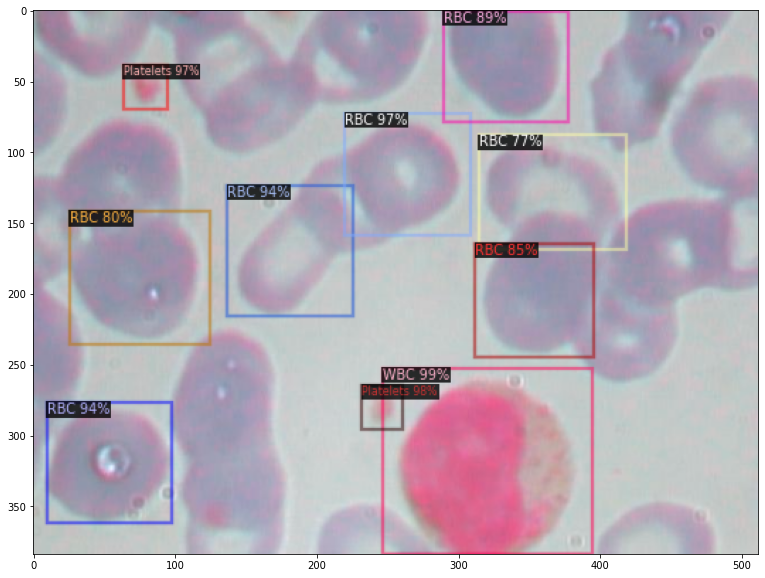

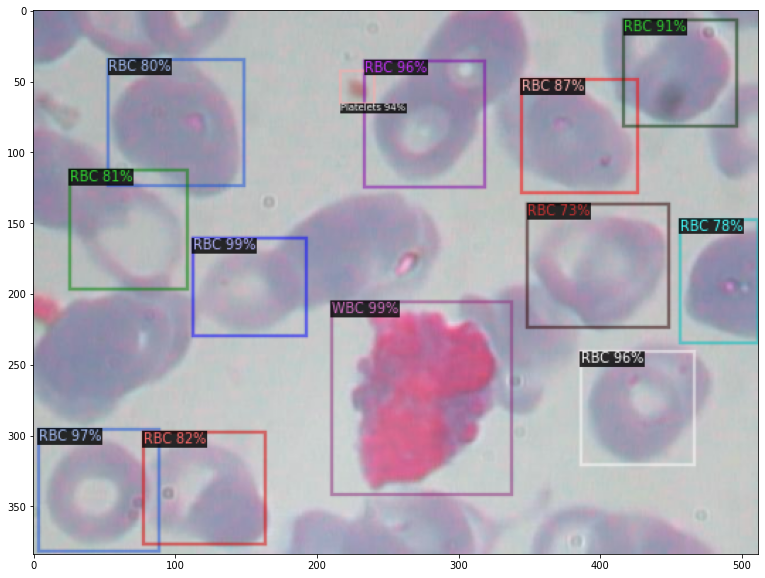

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('./test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  plt.figure(figsize=(20,10))
  plt.imshow(out.get_image()[:, :, ::-1])
  plt.show()
